In [2]:
import contextily as cx
import dask.array as da
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import planetary_computer
import rasterio as rio
from pystac_client import Client
from rasterio import transform, windows
from rasterio.enums import Resampling
from skimage.exposure import equalize_adapthist

In [3]:
# Parameter
date = "2024-06/2024-07"
modis_id = "modis-43A4-061"
landsat_id = "landsat-c2-l2"

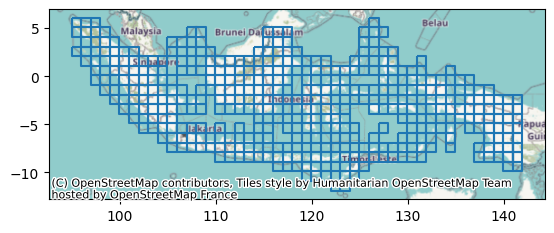

In [4]:
# Region of interest
grids = gpd.read_file(
    "https://storage.googleapis.com/gee-ramiqcom-bucket/eo-indonesia/grids.geojson",
)
ax = grids.boundary.plot()
cx.add_basemap(ax, crs="EPSG:4326")

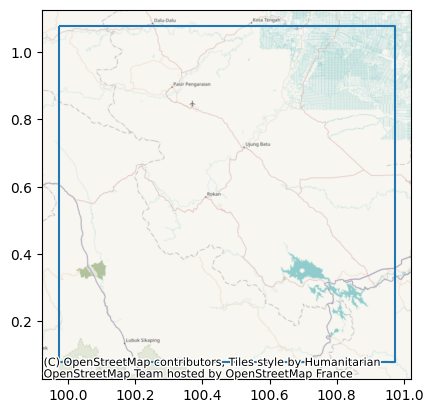

In [5]:
# Select grid no 25
grid_id = 31
roi = grids.iloc[grid_id : grid_id + 1]
ax = roi.boundary.plot()
bbox = roi.union_all().bounds
cx.add_basemap(ax, crs="EPSG:4326")

In [6]:
# Load STAC Client
client = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1/",
    modifier=planetary_computer.sign_inplace,
)

In [7]:
# Search for MODIS
modis_col = client.search(
    collections=[modis_id],
    datetime=date,
    bbox=bbox,
).item_collection()
modis_col

In [24]:
# Create median cloudless composite
modis_bands = [3, 4, 1, 2, 6, 7]
modis_image = []
for x in range(len(modis_col)):
    item = modis_col[x]
    assets = item.assets
    images = []

    for band in modis_bands:
        asset_name = f"Nadir_Reflectance_Band{band}"
        source = rio.open(assets[asset_name].href)
        window = windows.from_bounds(
            *roi.to_crs(source.crs).union_all().bounds,
            transform=source.transform,
        )
        image = source.read(
            1,
            boundless=True,
            fill_value=source.nodata,
            window=window,
            out_dtype="float32",
        )

        qc_name = f"BRDF_Albedo_Band_Mandatory_Quality_Band{band}"
        source_qc = rio.open(assets[qc_name].href)
        image_qc = source_qc.read(
            1,
            boundless=True,
            fill_value=source_qc.nodata,
            window=window,
        )
        mask = (image_qc & (1 << 0)) == 1

        image[(image == source.nodata) | ~mask] = np.nan
        image = da.from_array(image / 1e4, chunks="auto")
        images.append(image)

    modis_image.append(da.stack(images).rechunk("auto"))

modis_image = da.stack(modis_image).rechunk("auto")
modis_image = da.nanmedian(modis_image, axis=0).compute()
modis_image

array([[[0.01425   , 0.01385   , 0.0156    , ...,        nan,
                nan,        nan],
        [0.0147    , 0.0128    , 0.0124    , ..., 0.0505    ,
                nan,        nan],
        [0.0151    , 0.0164    , 0.0149    , ...,        nan,
                nan,        nan],
        ...,
        [0.0096    , 0.0073    , 0.0072    , ..., 0.0311    ,
         0.02695   , 0.0275    ],
        [0.0103    , 0.00855   , 0.0039    , ..., 0.0304    ,
         0.0273    , 0.0268    ],
        [0.0065    , 0.0069    , 0.00675   , ..., 0.03      ,
         0.0265    , 0.0229    ]],

       [[0.0499    , 0.04185   , 0.0497    , ...,        nan,
                nan,        nan],
        [0.0421    , 0.0393    , 0.03995   , ..., 0.0662    ,
                nan,        nan],
        [0.0477    , 0.0448    , 0.0442    , ...,        nan,
                nan,        nan],
        ...,
        [0.02805   , 0.03105   , 0.036     , ..., 0.05595   ,
         0.0601    , 0.0583    ],
        [0.0

c:\Users\ramiq\Learning\remote-sensing-python\.venv\lib\site-packages\skimage\util\dtype.py:338: RuntimeWarning: invalid value encountered in cast
  return image_out.astype(dtype_out)


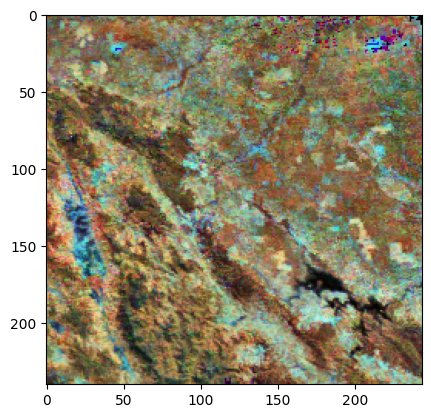

In [25]:
composite_modis = np.dstack(
    [
        equalize_adapthist(modis_image[3]),
        equalize_adapthist(modis_image[4]),
        equalize_adapthist(modis_image[5]),
    ],
)
plt.imshow(composite_modis)

In [26]:
output_image_modis = modis_image * 1e4
output_image_modis = np.nan_to_num(output_image_modis, nan=-9999)
with rio.open(
    f"temp/MODIS_Grid-{grid_id}_{date.replace('/', '_')}.tif",
    "w",
    "COG",
    count=output_image_modis.shape[0],
    width=output_image_modis.shape[2],
    height=output_image_modis.shape[1],
    compress="lzw",
    resample=Resampling.bilinear,
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform.from_bounds(
        *bbox,
        width=output_image_modis.shape[2],
        height=output_image_modis.shape[1],
    ),
    dtype="int16",
) as source:
    source.write(output_image_modis)

In [153]:
# Landsat client
client = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1/",
    modifier=planetary_computer.sign_inplace,
)

In [154]:
# Search for Landsat
landsat_col = client.search(
    collections=[landsat_id],
    datetime=date,
    bbox=bbox,
    query={"landsat:collection_category": {"eq": "T1"}},
).item_collection()
landsat_col

In [155]:
# Create median cloudless composite
landsat_bands = ["blue", "green", "red", "nir08", "swir16", "swir22"]
landsat_image = []
for x in range(len(landsat_col)):
    item = landsat_col[x]
    print(f"Processing: {item.id}")
    assets = item.assets
    images = []

    qa_source = rio.open(assets["qa_pixel"].href)
    window = windows.from_bounds(
        *roi.to_crs(qa_source.crs).union_all().bounds,
        transform=qa_source.transform,
    )
    qa_image = qa_source.read(
        1,
        boundless=True,
        fill_value=qa_source.nodata,
        window=window,
    )
    cloud_mask = (
        ((qa_image & (1 << 1)) == 0)
        & ((qa_image & (1 << 2)) == 0)
        & ((qa_image & (1 << 3)) == 0)
        & ((qa_image & (1 << 4)) == 0)
    )

    for band in landsat_bands:
        source = rio.open(assets[band].href)
        image = source.read(
            1,
            boundless=True,
            fill_value=source.nodata,
            window=window,
            out_dtype="float32",
        )

        image[(image == source.nodata) | ~cloud_mask] = np.nan
        image = da.from_array(image * 0.0000275 - 0.2, chunks="auto")
        images.append(image)

    landsat_image.append(da.stack(images).rechunk("auto"))

landsat_image = da.stack(landsat_image).rechunk("auto")
landsat_image = da.nanmedian(landsat_image, axis=0).compute()
landsat_image

Processing: LC08_L2SP_127060_20240725_02_T1
Processing: LC08_L2SP_127059_20240725_02_T1
Processing: LC09_L2SP_128060_20240724_02_T1
Processing: LC09_L2SP_128059_20240724_02_T1
Processing: LC09_L2SP_127060_20240717_02_T1
Processing: LC09_L2SP_127059_20240717_02_T1
Processing: LC08_L2SP_128060_20240716_02_T1
Processing: LC08_L2SP_128059_20240716_02_T1
Processing: LC09_L2SP_128059_20240708_02_T1
Processing: LC09_L2SP_127060_20240701_02_T1
Processing: LC09_L2SP_127059_20240701_02_T1
Processing: LC08_L2SP_128060_20240630_02_T1
Processing: LC08_L2SP_127060_20240623_02_T1
Processing: LC08_L2SP_127059_20240623_02_T1
Processing: LC09_L2SP_128060_20240622_02_T1
Processing: LC09_L2SP_128059_20240622_02_T1
Processing: LC09_L2SP_127060_20240615_02_T1
Processing: LC09_L2SP_127059_20240615_02_T1
Processing: LC08_L2SP_128060_20240614_02_T1
Processing: LC08_L2SP_128059_20240614_02_T1
Processing: LC08_L2SP_127060_20240607_02_T1
Processing: LC08_L2SP_127059_20240607_02_T1


array([[[       nan,        nan,        nan, ..., 0.04611125,
         0.04866875, 0.04891625],
        [       nan,        nan,        nan, ..., 0.04272875,
         0.04608375, 0.04836626],
        [       nan,        nan,        nan, ..., 0.039085  ,
         0.04033625, 0.04096875],
        ...,
        [0.0105125 , 0.01318   , 0.01966999, ..., 0.0187625 ,
         0.0190925 , 0.0188725 ],
        [0.0087525 , 0.00893125, 0.00814749, ..., 0.0181025 ,
         0.019945  , 0.0188175 ],
        [0.01289125, 0.00972874, 0.00630499, ..., 0.02107249,
         0.02052251, 0.01878999]],

       [[       nan,        nan,        nan, ..., 0.06472875,
         0.06503126, 0.06668125],
        [       nan,        nan,        nan, ..., 0.06284499,
         0.06566374, 0.06884   ],
        [       nan,        nan,        nan, ..., 0.05469126,
         0.05540626, 0.06052125],
        ...,
        [0.03023   , 0.0366925 , 0.0491225 , ..., 0.039635  ,
         0.0407625 , 0.039195  ],
        [0.0

c:\Users\ramiq\Learning\remote-sensing-python\.venv\lib\site-packages\skimage\util\dtype.py:338: RuntimeWarning: invalid value encountered in cast
  return image_out.astype(dtype_out)


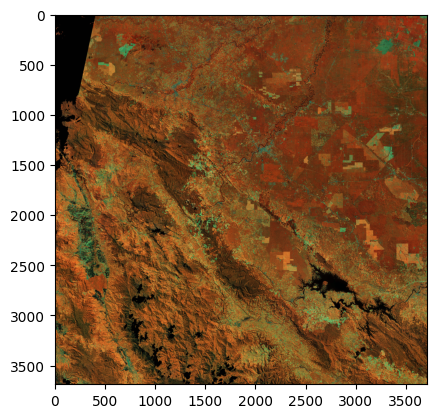

In [156]:
composite_landsat = np.dstack(
    [
        equalize_adapthist(landsat_image[3]),
        equalize_adapthist(landsat_image[4]),
        equalize_adapthist(landsat_image[5]),
    ],
)
plt.imshow(composite_landsat)

In [158]:
output_image_landsat = landsat_image * 1e4
output_image_landsat = np.nan_to_num(output_image_landsat, nan=-9999)
with rio.open(
    f"temp/Landsat_Grid-{grid_id}_{date.replace('/', '_')}.tif",
    "w",
    "COG",
    count=output_image_landsat.shape[0],
    width=output_image_landsat.shape[2],
    height=output_image_landsat.shape[1],
    compress="lzw",
    resample=Resampling.bilinear,
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform.from_bounds(
        *bbox,
        width=output_image_landsat.shape[2],
        height=output_image_landsat.shape[1],
    ),
    dtype="int16",
) as source:
    source.write(output_image_landsat)